In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

## Udemy: Data Analytics Real World Use Cases With Python

In [2]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import os 

In [3]:
files = sorted(os.listdir(r'../input/uber-pickups-in-new-york-city'))[-7:]
files


['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [4]:
files.remove('uber-raw-data-janjune-15.csv')
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

#### Concate into a single files

In [5]:
all_data = pd.DataFrame()

for file in files:
    df = pd.read_csv('../input/uber-pickups-in-new-york-city/' + file)
    all_data = pd.concat([all_data, df])

all_data.shape
    

(4534327, 4)

In [6]:
convert_todatetime = all_data.copy()
convert_todatetime.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [7]:
convert_todatetime['Date/Time'] = pd.to_datetime(convert_todatetime['Date/Time'])
convert_todatetime.dtypes
convert_todatetime.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


#### Augment data with additional column

In [8]:
all_data['Day of week'] = convert_todatetime['Date/Time'].dt.day_name()
all_data['Day'] = convert_todatetime['Date/Time'].dt.day
all_data['Hour'] = convert_todatetime['Date/Time'].dt.hour
all_data['Minute'] = convert_todatetime['Date/Time'].dt.minute
all_data['Month'] = convert_todatetime['Date/Time'].dt.month
all_data.head()
all_data.dtypes

Date/Time       object
Lat            float64
Lon            float64
Base            object
Day of week     object
Day              int64
Hour             int64
Minute           int64
Month            int64
dtype: object

#### Question 1: The most journey for the day of the week 

In [9]:
import plotly.express as px

In [10]:
all_data['Day of week'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Day of week, dtype: int64

In [11]:
px.bar(x=all_data['Day of week'].value_counts().index,
      y=all_data['Day of week'].value_counts(),
     labels={'x': 'Day of week', 'y':'Counts'})

#### Question 2: Analysis of Journey by Hour

In [12]:
for i,month in enumerate(all_data['Month'].unique()):
    print(str(i) + " i")
    print(str(month) + " month")


0 i
4 month
1 i
8 month
2 i
7 month
3 i
6 month
4 i
5 month
5 i
9 month


In [13]:
# Getting the index where the month is equal to 9
all_data[all_data['Month']==9]

,Date/Time,Lat,Lon,Base,Day of week,Day,Hour,Minute,Month
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512,Monday,1,0,1,9
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512,Monday,1,0,1,9
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512,Monday,1,0,3,9
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512,Monday,1,0,6,9
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512,Monday,1,0,11,9
...,...,...,...,...,...,...,...,...,...
1028131,9/30/2014 22:57:00,40.7668,-73.9845,B02764,Tuesday,30,22,57,9
1028132,9/30/2014 22:57:00,40.6911,-74.1773,B02764,Tuesday,30,22,57,9
1028133,9/30/2014 22:58:00,40.8519,-73.9319,B02764,Tuesday,30,22,58,9
1028134,9/30/2014 22:58:00,40.7081,-74.0066,B02764,Tuesday,30,22,58,9


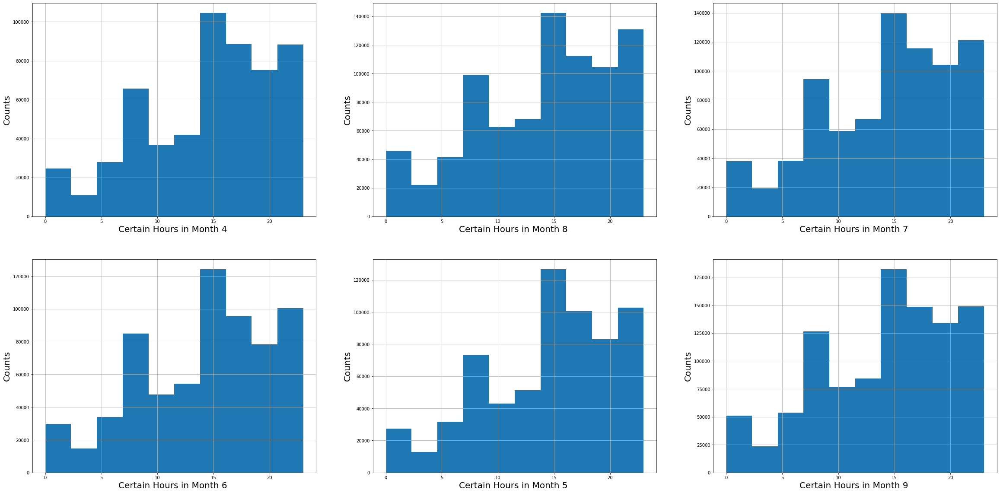

In [14]:
plt.figure(figsize=(40,20))

for i,month in enumerate(all_data['Month'].unique()):
    plt.subplot(2,3,i+1)
    plt.xlabel('Certain Hours in Month {} '.format(month) ,fontsize=20)
    plt.ylabel('Counts', fontsize=20)
    all_data[all_data['Month']==month]['Hour'].hist()


In [15]:
all_data.head()

,Date/Time,Lat,Lon,Base,Day of week,Day,Hour,Minute,Month
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512,Tuesday,1,0,11,4
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512,Tuesday,1,0,17,4
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512,Tuesday,1,0,21,4
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512,Tuesday,1,0,28,4
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512,Tuesday,1,0,33,4


In [16]:
!pip install chart_studio

     |████████████████████████████████| 64 kB 677 kB/s 


#### Question 4: Which month has the highest rides

In [17]:
import chart_studio.plotly as py 
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [18]:
num_of_rides_in_months = all_data.groupby('Month')['Hour'].count()
num_of_rides_in_months

Month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: Hour, dtype: int64

In [19]:
trace1=go.Bar(
    x=all_data.groupby('Month')['Hour'].count().index,
    y=all_data.groupby('Month')['Hour'].count(),
    name='Priority'
)

In [20]:
iplot([trace1])

#### Question 5: Analysis Journey of Each Day

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='Day', ylabel='Density'>

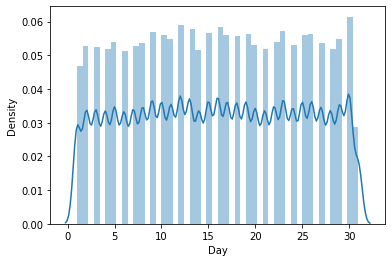

In [21]:
sns.distplot(all_data['Day'])

Text(0.5, 1.0, 'Journey by month day')

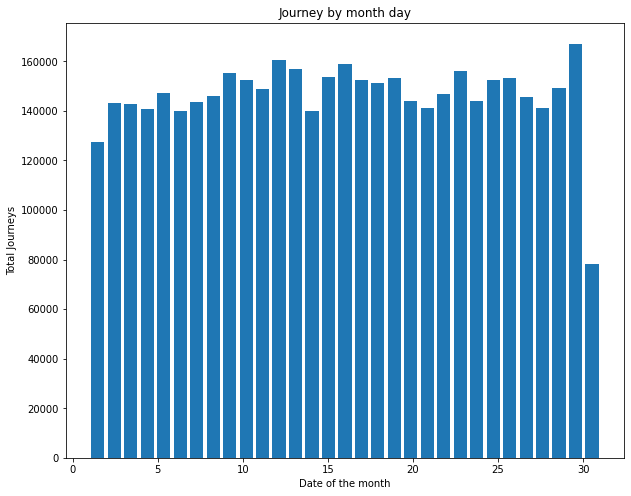

In [22]:
plt.figure(figsize=(10,8))
plt.hist(all_data['Day'], bins=31, rwidth=0.8) # bins is the number of equal width in the graphs
plt.xlabel('Date of the month')
plt.ylabel('Total Journeys')
plt.title('Journey by month day')

#### Question 6: Analysis of Total rides per Month

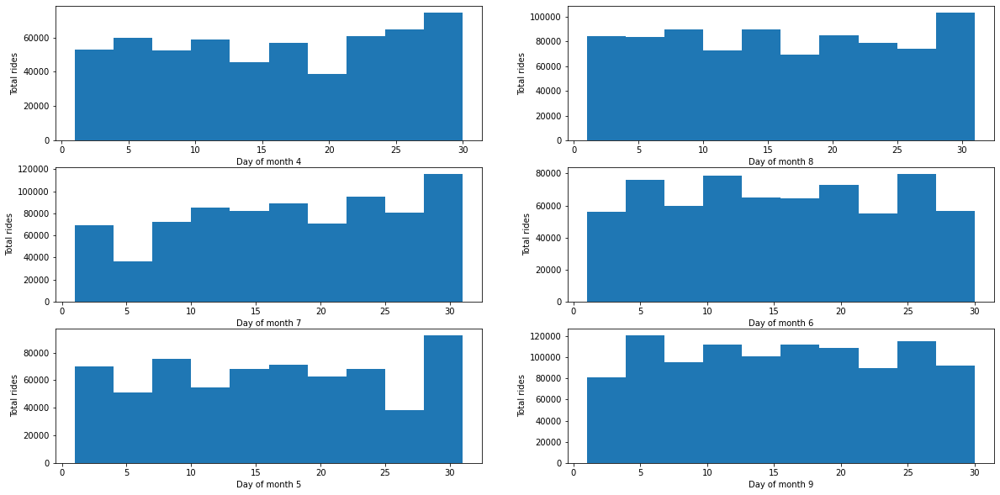

In [23]:
plt.figure(figsize=(20,10))

for i, month in enumerate(all_data['Month'].unique(),1): 
    plt.subplot(3,2,i)
    df_out = all_data[all_data['Month']==month]
    plt.hist(df_out['Day'])
    plt.xlabel('Day of month {}'.format(month))
    plt.ylabel('Total rides')

#### Question 7: Analysising Rush Hour

Text(0.5, 1.0, 'offday vs Base of passenger')

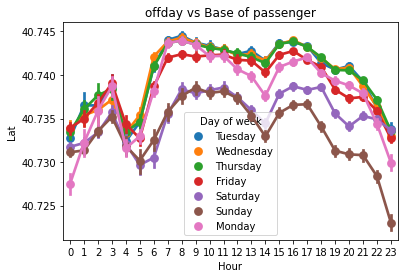

In [24]:
ax = sns.pointplot(x='Hour', y='Lat',data=all_data, hue='Day of week')
ax.set_title('offday vs Base of passenger')

#### Question 8: Which base number is most popular by month

In [25]:
base = all_data.groupby(['Base', 'Month'])['Date/Time'].count().reset_index()
base

,Base,Month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<AxesSubplot:xlabel='Month', ylabel='Date/Time'>

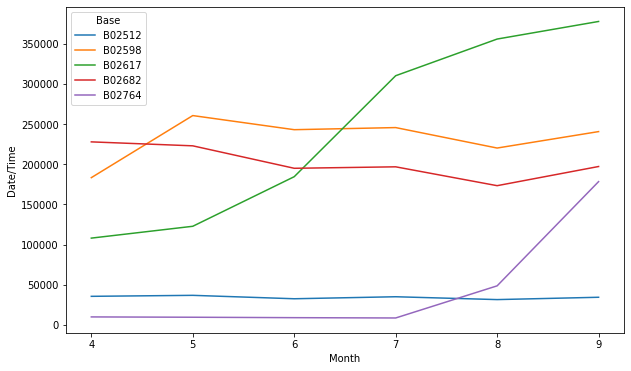

In [26]:
plt.figure(figsize=(10,6))

sns.lineplot(x='Month', y='Date/Time', data=base, hue='Base')

#### Question 9: HeatMap Exploration

In [27]:
# all_data.value_counts(subset=['Day of week', 'Hour']) 
dayofweek_hour = all_data.groupby(['Day of week', 'Hour']).size()
dayofweek_hour


Day of week  Hour
Friday       0       13716
             1        8163
             2        5350
             3        6930
             4        8806
                     ...  
Wednesday    19      47017
             20      47772
             21      44553
             22      32868
             23      18146
Length: 168, dtype: int64

In [28]:
pivot = dayofweek_hour.unstack()
pivot

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day of week,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='Hour', ylabel='Day of week'>

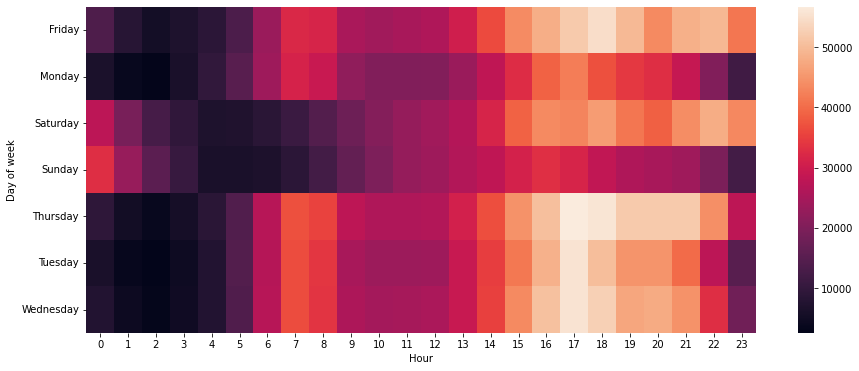

In [29]:
plt.figure(figsize=(15,6))
sns.heatmap(pivot)

In [30]:
def heatmap(col1, col2):
    by_cross = all_data.groupby([col1, col2]).size()
    pivot = by_cross.unstack()
    plt.figure(figsize=(15,6))
    return sns.heatmap(pivot)

#### Heatmap by Hour and Day

<AxesSubplot:xlabel='Day', ylabel='Hour'>

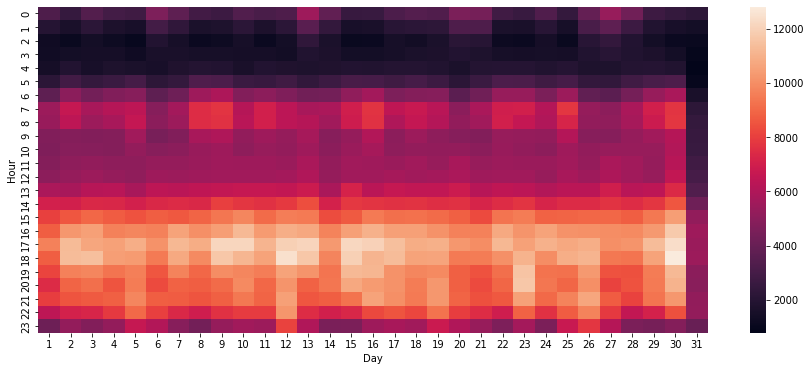

In [31]:
heatmap('Hour', 'Day')

#### Heatmap by Month and Day

<AxesSubplot:xlabel='Day', ylabel='Month'>

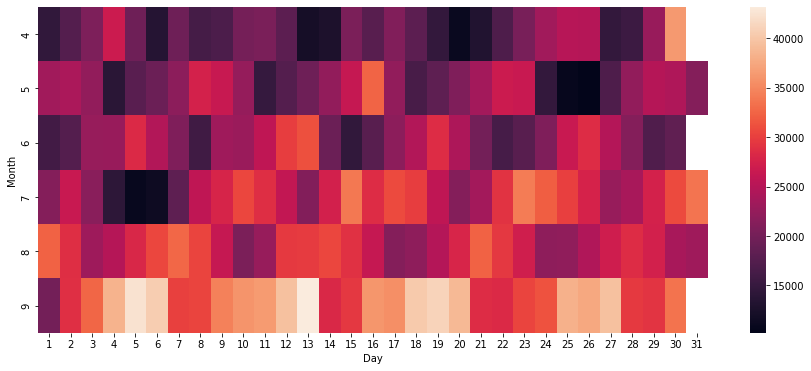

In [32]:
heatmap('Month', 'Day')

#### Heatmap by Month and Weekday

<AxesSubplot:xlabel='Month', ylabel='Day of week'>

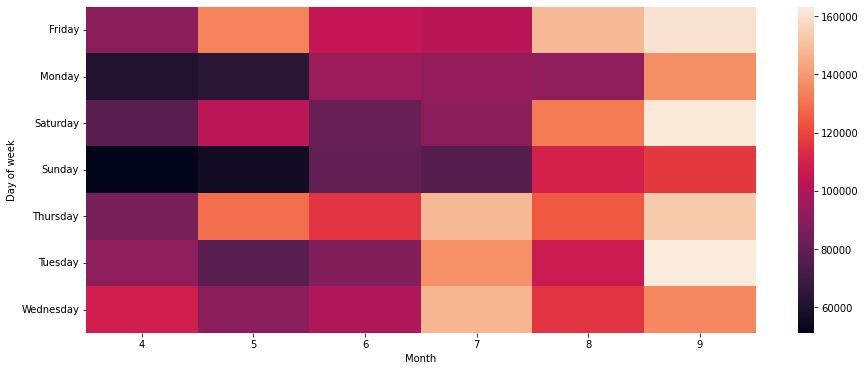

In [33]:
heatmap('Day of week', 'Month')

#### Question 10: Perform Spatial Analysis using heatmap to get a clear cut of Rush

In [34]:
df_out = all_data[all_data['Day of week']=='Friday']
group = df_out.groupby(['Lat','Lon'])['Day of week'].count().reset_index()
group

,Lat,Lon,Day of week
0,39.6569,-74.2258,1
1,39.9701,-74.0662,1
2,39.9769,-74.0659,1
3,39.9819,-74.0661,1
4,39.9947,-74.0634,1
...,...,...,...
246351,41.3000,-74.1847,1
246352,41.3225,-72.9634,1
246353,41.3476,-73.6709,1
246354,41.5016,-72.8987,1


In [35]:
coordinates = all_data.groupby(['Lat', 'Lon'])['Day of week'].count().reset_index()
coordinates

,Lat,Lon,Day of week
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1
...,...,...,...
574553,41.3730,-72.9237,1
574554,41.3737,-73.7988,1
574555,41.5016,-72.8987,1
574556,41.5276,-72.7734,2


In [36]:
coordinates.columns=['Lat', 'Lon', 'no of trips']
coordinates

,Lat,Lon,no of trips
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1
...,...,...,...
574553,41.3730,-72.9237,1
574554,41.3737,-73.7988,1
574555,41.5016,-72.8987,1
574556,41.5276,-72.7734,2


In [37]:
from folium.plugins import HeatMap 

In [38]:
import folium

In [39]:
basemap = folium.Map()

In [40]:
HeatMap(coordinates,zoom=20,radius=15).add_to(basemap)
basemap

#### Question 11: Automate your Analysis

In [41]:
def plot(df, day):
    basemap = folium.Map()
    df_out = all_data[all_data['Day of week']==day]
    HeatMap(df_out.groupby(['Lat', 'Lon'])['Day of week'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap


In [42]:
plot(all_data,'Friday')

#### Data Preparation

In [43]:
uber_janjune = pd.read_csv('../input/uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv')
uber_janjune.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [44]:
uber_janjune['Pickup_date'] = pd.to_datetime(uber_janjune['Pickup_date'])
uber_janjune.dtypes
uber_janjune.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


#### Augment data with additional column

In [45]:
uber_janjune['Day of week'] = uber_janjune['Pickup_date'].dt.day_name()
uber_janjune['Day'] = uber_janjune['Pickup_date'].dt.day
uber_janjune['Month'] = uber_janjune['Pickup_date'].dt.month
uber_janjune['Hour'] = uber_janjune['Pickup_date'].dt.hour
uber_janjune.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Day of week,Day,Month,Hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,9


In [46]:
data_janjune = px.bar(x=uber_janjune['Month'].value_counts().index,
               y=uber_janjune['Month'].value_counts(),
            labels={'x': 'Month', 'y':'Counts'})
data_janjune


#### Question 12: Rush Hour in NYC during Jan-June

<AxesSubplot:xlabel='Hour', ylabel='count'>

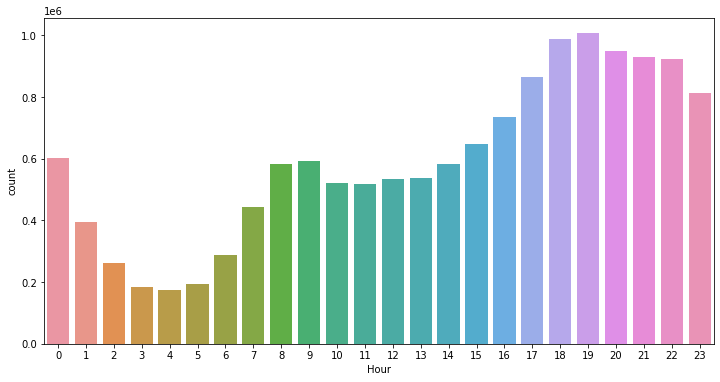

In [47]:
plt.figure(figsize=(12,6))
sns.countplot(x="Hour",data=uber_janjune) 

#### Question 13: In-Depth Analysis of Rush Hour/Day in NYC

In [48]:
uber_rush_day_hour = uber_janjune.groupby(['Day of week', 'Hour'])['Pickup_date'].count().reset_index()
uber_rush_day_hour.columns=['Day of week','Hour','Trips']
uber_rush_day_hour.head()

,Day of week,Hour,Trips
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


<AxesSubplot:xlabel='Hour', ylabel='Trips'>

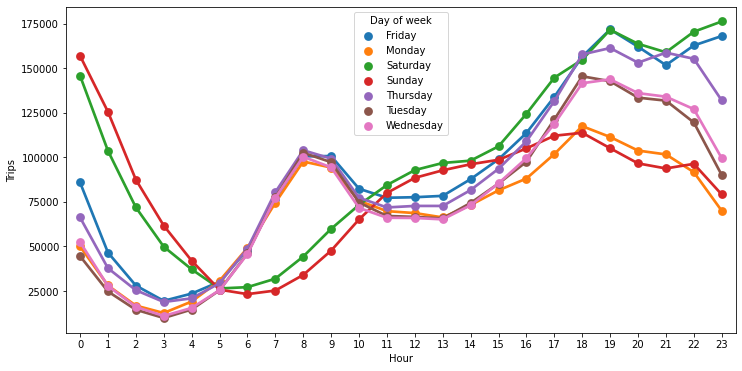

In [49]:
plt.figure(figsize=(12,6))
sns.pointplot(x='Hour',y='Trips',hue='Day of week',data=uber_rush_day_hour)

In [50]:
uber_foil = pd.read_csv('../input/uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv')
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


#### Question 14: Which Base has the most active vehicles

In [51]:
most_vehicles = uber_foil.groupby('dispatching_base_number')['active_vehicles'].sum()
most_vehicles

dispatching_base_number
B02512     13125
B02598     58653
B02617     79758
B02682     71431
B02764    217290
B02765     22575
Name: active_vehicles, dtype: int64

<Figure size 1440x720 with 0 Axes>

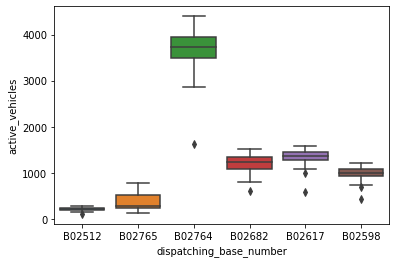

<Figure size 1440x720 with 0 Axes>

In [52]:
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uber_foil)
plt.figure(figsize=(20,10))

#### Question 15: Which base has the most trips

In [53]:
most_trips = uber_foil.groupby('dispatching_base_number')['trips'].sum()
most_trips

dispatching_base_number
B02512      93786
B02598     540791
B02617     725025
B02682     662509
B02764    1914449
B02765     193670
Name: trips, dtype: int64

<Figure size 1440x720 with 0 Axes>

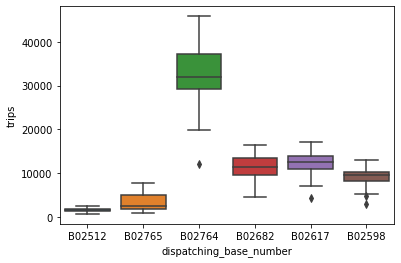

<Figure size 1440x720 with 0 Axes>

In [54]:
sns.boxplot(x='dispatching_base_number',y='trips',data=uber_foil)
plt.figure(figsize=(20,10))

#### Question 16: Average trips/vehicle increase or decrease  with respect to base number

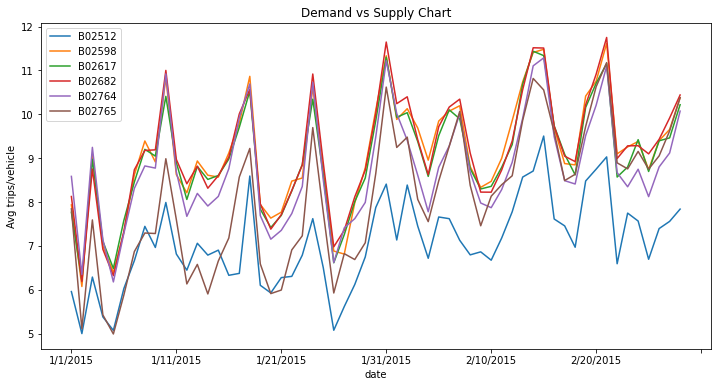

In [55]:
plt.figure(figsize=(12,6))
uber_foil['trips/vehicle'] = uber_foil['trips']/uber_foil['active_vehicles']
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.xlabel('date')
plt.title('Demand vs Supply Chart')
plt.ylabel('Avg trips/vehicle')
plt.legend()